<a href="https://colab.research.google.com/github/mfaiqrofifi/Thesis_AI/blob/main/Simulation_2_Thesis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/SimulationThesis-02

/content/drive/MyDrive/SimulationThesis-02


In [ ]:
%cd /content

/content


In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 3.7 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15737, done.
remote: Counting objects: 100% (460/460), done.
remote: Compressing objects: 100% (339/339), done.
remote: Total 15737 (delta 211), reused 304 (delta 112), pack-reused 15277
Receiving objects: 100% (15737/15737), 6.52 MiB | 8.82 MiB/s, done.
Resolving deltas: 100% (11323/11323), done.


No CUDA runtime is found, using CUDA_HOME='/usr/local/cuda'


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 36.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 12.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61400 sha256=268baa618414af7e06e3a53d90f1b110afaae6bbefac977574e92a31a3c7c4b9
  Stored in directory: /root/.cache/pip/wheels/01/c0/af/77c1cf53a1be9e42a52b48e5af2169d40ec2e89f7362489dd0
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=f2d81121a92c265ca31c194b602bc87219ceca76d2d49fc49f7ceaeee85ac1bb
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a1

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.3 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
!mkdir dataset

In [ ]:
%cd ./dataset

/content/dataset


In [ ]:
!git clone https://github.com/immersive-limit/coco-manager.git

Cloning into 'coco-manager'...
remote: Enumerating objects: 8, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 8 (delta 2), reused 5 (delta 0), pack-reused 0
Receiving objects: 100% (8/8), done.
Resolving deltas: 100% (2/2), done.


In [ ]:
!wget http://images.cocodataset.org/annotations/annotations_trainval2017.zip
!unzip /content/dataset/annotations_trainval2017.zip

--2024-04-19 11:21:31--  http://images.cocodataset.org/annotations/annotations_trainval2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 54.231.197.73, 16.182.98.89, 52.216.35.185, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|54.231.197.73|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252907541 (241M) [application/zip]
Saving to: ‘annotations_trainval2017.zip’

annotations_trainva 100%[===================>] 241.19M  14.0MB/s    in 19s     

2024-04-19 11:21:51 (12.5 MB/s) - ‘annotations_trainval2017.zip’ saved [252907541/252907541]

Archive:  /content/dataset/annotations_trainval2017.zip
  inflating: annotations/instances_train2017.json  
  inflating: annotations/instances_val2017.json  
  inflating: annotations/captions_train2017.json  
  inflating: annotations/captions_val2017.json  
  inflating: annotations/person_keypoints_train2017.json  
  inflating: annotations/person_keypoints_val2017.json  


In [ ]:
!pip install CocoDataset==0.1.2

In [ ]:
!mkdir newAnnotation

In [ ]:
%cd ./coco-manager

/content/dataset/coco-manager


In [ ]:
!python filter.py --input_json ../annotations/instances_train2017.json --output_json ../newAnnotation/data.json --categories cow sheep horse

Loading json file...
Processing input json...
Filtering...
Saving new json file...
Filtered json saved.


In [ ]:
%cd ..

/content/dataset


In [ ]:
%mkdir data
%cd data

/content/dataset/data


In [ ]:
!pip install pycocotools

In [ ]:
%cd ../data/data_train

[Errno 2] No such file or directory: '../data/data_train'
/content/dataset/data


In [ ]:
%mkdir data_train
%cd data_train

/content/dataset/data/data_train


In [ ]:
%cd /content/dataset/data/data_train

/content/dataset/data/data_train


In [ ]:
%pwd

'/content/dataset/data/data_train'

In [ ]:
from pycocotools.coco import COCO
import requests

# instantiate COCO specifying the annotations json path
coco = COCO('../../newAnnotation/data.json')
# Specify a list of category names of interest
catIds = coco.getCatIds(catNms=['train2017'])
# Get the corresponding image ids and images using loadImgs
imgIds = coco.getImgIds(catIds=catIds)
images = coco.loadImgs(imgIds)

for im in images:
    img_data = requests.get(im['coco_url']).content
    with open('./' + im['file_name'], 'wb') as handler:
        handler.write(img_data)

loading annotations into memory...
Done (t=0.72s)
creating index...
index created!


In [ ]:
%cd /content/dataset/coco-manager

/content/dataset/coco-manager


In [ ]:
!python filter.py --input_json /content/dataset/annotations/instances_val2017.json --output_json /content/dataset/newAnnotation/dataVal.json --categories cow sheep horse

Loading json file...
Processing input json...
Filtering...
Saving new json file...
Filtered json saved.


In [ ]:
%cd /content/dataset/data

/content/dataset/data


In [ ]:
%mkdir data_val
%cd /content/dataset/data/data_val

/content/dataset/data/data_val


In [ ]:
from pycocotools.coco import COCO
import requests

# instantiate COCO specifying the annotations json path
coco = COCO('/content/dataset/newAnnotation/dataVal.json')
# Specify a list of category names of interest
catIds = coco.getCatIds(catNms=['val2017'])
# Get the corresponding image ids and images using loadImgs
imgIds = coco.getImgIds(catIds=catIds)
images = coco.loadImgs(imgIds)

for im in images:
    img_data = requests.get(im['coco_url']).content
    with open('/content/dataset/data/data_val/' + im['file_name'], 'wb') as handler:
        handler.write(img_data)

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train1", {}, "/content/dataset/newAnnotation/data.json", "/content/dataset/data/data_train")
register_coco_instances("my_dataset_val1", {}, "/content/dataset/newAnnotation/dataVal.json", "/content/dataset/data/data_val")

In [ ]:
MetadataCatalog.get("my_dataset_train1").set(thing_classes=["horse","sheep","cow"])
MetadataCatalog.get("my_dataset_val1").set(thing_classes=["horse","sheep","cow"])

namespace(name='my_dataset_val1',
          json_file='/content/dataset/newAnnotation/dataVal.json',
          image_root='/content/dataset/data/data_val',
          evaluator_type='coco',
          thing_classes=['horse', 'sheep', 'cow'])

In [ ]:
train_dataset1=MetadataCatalog.get("my_dataset_train1")

In [ ]:
test_dtset=DatasetCatalog.get("my_dataset_val1")

[04/17 04:19:43 d2.data.datasets.coco]: Loaded 267 images in COCO format from /content/dataset/newAnnotation/dataVal.json


In [ ]:
train_dataset1

namespace(name='my_dataset_train1',
          json_file='/content/dataset/newAnnotation/data.json',
          image_root='/content/dataset/data/data_train',
          evaluator_type='coco',
          thing_classes=['horse', 'sheep', 'cow'])

In [ ]:
train_dtset=DatasetCatalog.get("my_dataset_train1")

[04/17 04:19:54 d2.data.datasets.coco]: Loaded 6161 images in COCO format from /content/dataset/newAnnotation/data.json


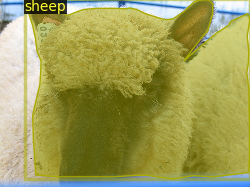

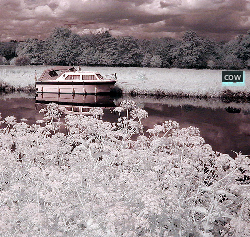

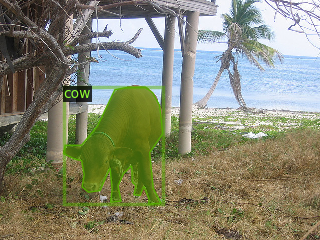

In [ ]:
for d in random.sample(train_dtset,3):
  img=cv2.imread(d["file_name"])
  visualizer=Visualizer(img[:,:,::-1],metadata=train_dataset1,scale=0.5)
  vis=visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:,:,::-1])

In [ ]:
from detectron2.engine import DefaultTrainer
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train1",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[04/17 04:20:52 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:02, 113MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[04/17 04:20:56 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/17 04:21:13 d2.utils.events]:  eta: 0:02:48  iter: 19  total_loss: 2.983  loss_cls: 1.403  loss_box_reg: 0.8616  loss_mask: 0.6919  loss_rpn_cls: 0.01383  loss_rpn_loc: 0.00867    time: 0.6061  last_time: 0.6462  data_time: 0.0132  last_data_time: 0.0030   lr: 1.6068e-05  max_mem: 3506M
[04/17 04:21:29 d2.utils.events]:  eta: 0:02:40  iter: 39  total_loss: 2.679  loss_cls: 1.221  loss_box_reg: 0.7267  loss_mask: 0.6821  loss_rpn_cls: 0.01202  loss_rpn_loc: 0.01566    time: 0.6156  last_time: 0.5308  data_time: 0.0055  last_data_time: 0.0046   lr: 3.2718e-05  max_mem: 3506M
[04/17 04:21:41 d2.utils.events]:  eta: 0:02:29  iter: 59  total_loss: 2.22  loss_cls: 0.8529  loss_box_reg: 0.6961  loss_mask: 0.6541  loss_rpn_cls: 0.01146  loss_rpn_loc: 0.01236    time: 0.6219  last_time: 0.6396  data_time: 0.0050  last_data_time: 0.0054   lr: 4.9367e-05  max_mem: 3649M
[04/17 04:21:54 d2.utils.events]:  eta: 0:02:18  iter: 79  total_loss: 2.054  loss_cls: 0.5971  loss_box_reg: 0.8662  loss_m

In [ ]:
%pwd

'/content/dataset/data/data_val'

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/dataset/data/data_val/output/model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[04/17 04:25:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/dataset/data/data_val/output/model_final.pth ...


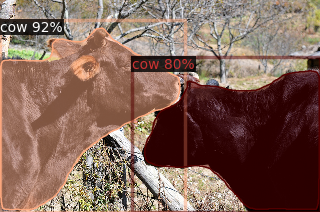

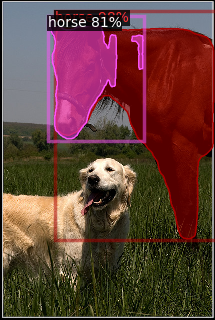

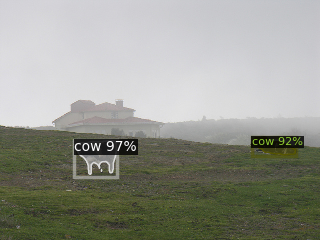

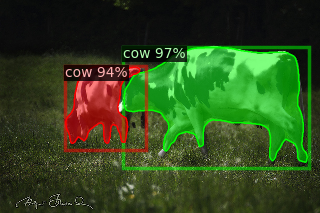

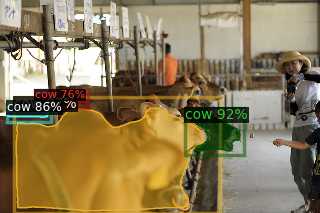

In [ ]:
from detectron2.utils.visualizer import ColorMode

def show_img(path,extra=False):
  im=cv2.imread(path)
  outputs=predictor(im)
  if extra:
    print(outputs['instances'].pred_classes)
    print(outputs['instances'].pred_boxes)


# im = cv2.imread("/content/dataset/cowTrain/000000001083.jpg")
# outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
# v = Visualizer(im[:, :, ::-1],
#                    metadata=train_dataset1,
#                    scale=0.5,
#                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
#     )
# out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
# cv2_imshow(out.get_image()[:, :, ::-1])

for d in random.sample(test_dtset, 5):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=train_dataset1,
                   scale=0.5,
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
#d = "val"
#DatasetCatalog.register("balloon_" + d, lambda d=d: get_dicts("balloon/" + d))
#MetadataCatalog.get("balloon_" + d).set(thing_classes=["balloon"])

#dataset_dicts = get_dicts("balloon/val")
from detectron2.modeling import build_model
model = build_model(cfg)
from detectron2.checkpoint import DetectionCheckpointer
DetectionCheckpointer(model).load("/content/dataset/data/data_val/output/model_final.pth")

checkpointer = DetectionCheckpointer(model, save_dir="output")
checkpointer.save("new_model")

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_val1", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_val1")
print(inference_on_dataset(model, val_loader, evaluator))

[04/17 04:26:56 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/dataset/data/data_val/output/model_final.pth ...
[04/17 04:26:57 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [04/17 04:26:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[04/17 04:26:57 d2.data.datasets.coco]: Loaded 267 images in COCO format from /content/dataset/newAnnotation/dataVal.json
[04/17 04:26:57 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   horse    | 272          |   sheep    | 354          |    cow     | 372          |
|            |              |            |              |            |              |
|   total    | 998   

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[04/17 04:26:59 d2.evaluation.evaluator]: Inference done 11/267. Dataloading: 0.0014 s/iter. Inference: 0.1446 s/iter. Eval: 0.0017 s/iter. Total: 0.1478 s/iter. ETA=0:00:37
[04/17 04:27:04 d2.evaluation.evaluator]: Inference done 44/267. Dataloading: 0.0017 s/iter. Inference: 0.1480 s/iter. Eval: 0.0021 s/iter. Total: 0.1520 s/iter. ETA=0:00:33
[04/17 04:27:09 d2.evaluation.evaluator]: Inference done 78/267. Dataloading: 0.0017 s/iter. Inference: 0.1460 s/iter. Eval: 0.0021 s/iter. Total: 0.1500 s/iter. ETA=0:00:28
[04/17 04:27:14 d2.evaluation.evaluator]: Inference done 111/267. Dataloading: 0.0017 s/iter. Inference: 0.1469 s/iter. Eval: 0.0021 s/iter. Total: 0.1508 s/iter. ETA=0:00:23
[04/17 04:27:19 d2.evaluation.evaluator]: Inference done 144/267. Dataloading: 0.0017 s/iter. Inference: 0.1473 s/iter. Eval: 0.0022 s/iter. Total: 0.1513 s/iter. ETA=0:00:18
[04/17 04:27:24 d2.evaluation.evaluator]: Inference done 177/267. Dataloading: 0.0018 s/iter. Inference: 0.1480 s/iter. Eval: 0.

In [ ]:
!pip install opencv-python pytube

# youtube_url = "https://www.youtube.com/watch?v=uNqFbEng7_A&ab_channel=alittaalitta"
#     output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
#     os.makedirs(output_folder, exist_ok=True)
#     output_path = os.path.join(output_folder, "downloaded_simulation-03.mp4")
#     model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
#     start_time = 0  # Start time in seconds
#     end_time = 60  # End time in seconds

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.9 MB/s eta 0:00:00


In [ ]:
!pip install kaggle
from google.colab import files
files.upload()  # Unggah kaggle.json yang berisi API token Anda

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!kaggle datasets download -d andrewmvd/sheep-detection
!unzip sheep-detection.zip -d sheep_detection

Dataset URL: https://www.kaggle.com/datasets/andrewmvd/sheep-detection
License(s): CC0-1.0
User cancelled operation
unzip:  cannot find or open sheep-detection.zip, sheep-detection.zip.zip or sheep-detection.zip.ZIP.


In [ ]:
!kaggle datasets download -d trainingdatapro/cows-detection-dataset
!unzip cows-detection-dataset.zip -d cows_detection

Dataset URL: https://www.kaggle.com/datasets/trainingdatapro/cows-detection-dataset
License(s): Attribution-NonCommercial-NoDerivatives 4.0 International (CC BY-NC-ND 4.0)
 99% 174M/175M [00:01<00:00, 109MB/s]
100% 175M/175M [00:01<00:00, 111MB/s]
Archive:  cows-detection-dataset.zip
  inflating: cows_detection/annotations.xml  
  inflating: cows_detection/boxes/0.png  
  inflating: cows_detection/boxes/1.png  
  inflating: cows_detection/boxes/10.png  
  inflating: cows_detection/boxes/11.png  
  inflating: cows_detection/boxes/14.png  
  inflating: cows_detection/boxes/15.png  
  inflating: cows_detection/boxes/16.png  
  inflating: cows_detection/boxes/17.png  
  inflating: cows_detection/boxes/18.png  
  inflating: cows_detection/boxes/19.png  
  inflating: cows_detection/boxes/2.png  
  inflating: cows_detection/boxes/20.png  
  inflating: cows_detection/boxes/22.png  
  inflating: cows_detection/boxes/24.png  
  inflating: cows_detection/boxes/25.png  
  inflating: cows_detection

In [ ]:
!kaggle datasets download -d olgabelitskaya/horse-breeds
!unzip horse-breeds.zip -d horse_breeds

Dataset URL: https://www.kaggle.com/datasets/olgabelitskaya/horse-breeds
License(s): other
 98% 80.0M/82.0M [00:05<00:00, 22.6MB/s]
100% 82.0M/82.0M [00:05<00:00, 16.2MB/s]
Archive:  horse-breeds.zip
  inflating: horse_breeds/01_001.png  
  inflating: horse_breeds/01_002.png  
  inflating: horse_breeds/01_003.png  
  inflating: horse_breeds/01_004.png  
  inflating: horse_breeds/01_005.png  
  inflating: horse_breeds/01_006.png  
  inflating: horse_breeds/01_007.png  
  inflating: horse_breeds/01_008.png  
  inflating: horse_breeds/01_009.png  
  inflating: horse_breeds/01_010.png  
  inflating: horse_breeds/01_011.png  
  inflating: horse_breeds/01_012.png  
  inflating: horse_breeds/01_013.png  
  inflating: horse_breeds/01_014.png  
  inflating: horse_breeds/01_015.png  
  inflating: horse_breeds/01_016.png  
  inflating: horse_breeds/01_017.png  
  inflating: horse_breeds/01_018.png  
  inflating: horse_breeds/01_019.png  
  inflating: horse_breeds/01_020.png  
  inflating: horse_b

In [ ]:
!wget -P /content/drive/MyDrive/SimulationThesis-02/horse/ "https://calvin-vision.net/datasets/inria-horses/inria-horses-v1.0.tgz"
!tar -xzf /content/drive/MyDrive/SimulationThesis-02/horse/inria-horses-v1.0.tgz -C /content/drive/MyDrive/SimulationThesis-02/horse/

--2024-07-16 05:04:21--  https://calvin-vision.net/datasets/inria-horses/inria-horses-v1.0.tgz
Resolving calvin-vision.net (calvin-vision.net)... 162.241.226.109
Connecting to calvin-vision.net (calvin-vision.net)|162.241.226.109|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2024-07-16 05:04:23 ERROR 404: Not Found.

tar (child): /content/drive/MyDrive/SimulationThesis-02/horse/inria-horses-v1.0.tgz: Cannot open: No such file or directory
tar (child): Error is not recoverable: exiting now
tar: Child returned status 2
tar: Error is not recoverable: exiting now


In [ ]:
import os
import random
import shutil

# Tentukan path input dan output
input_folder = '/content/horse_breeds'
output_folder = '/content/drive/MyDrive/SimulationThesis-02/HORSES_Detection_Random_Sample'

# Buat folder output jika belum ada
os.makedirs(output_folder, exist_ok=True)

# Dapatkan semua nama file gambar
all_images = [f for f in os.listdir(input_folder) if f.endswith('.jpg') or f.endswith('.png')]

# Pilih 10 gambar acak
random_images = random.sample(all_images, 10)

# Pindahkan gambar-gambar yang dipilih ke folder output di Google Drive
for img in random_images:
    shutil.move(os.path.join(input_folder, img), os.path.join(output_folder, img))


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import os

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes = ["horse", "sheep", "cow"]
    return dataset_name

# Fungsi untuk memproses gambar
def process_image(image_path, predictor, metadata_name, output_path):
    image = cv2.imread(image_path)
    outputs = predictor(image)

    instances = outputs["instances"].to("cpu")
    pred_classes = instances.pred_classes.tolist()
    class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
    out_frame = v.draw_instance_predictions(instances)
    vis_frame = out_frame.get_image()[:, :, ::-1].copy()

    x, y = 10, 30
    for class_name, count in class_counts.items():
        text = f"{class_name}: {count}"
        cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        y += 40

    # Simpan gambar hasil
    cv2.imwrite(output_path, vis_frame)

def main():
    image_folder = "/content/drive/MyDrive/SimulationThesis-02/HORSES_Detection_Random_Sample"  # Update with your image folder path
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/HORSE_Detection_Output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path

    # Register metadata
    metadata_name = register_metadata()

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process all images in the folder
    for image_name in os.listdir(image_folder):
        image_path = os.path.join(image_folder, image_name)
        if os.path.isfile(image_path) and image_path.endswith(('.png', '.jpg', '.jpeg')):
            output_image_path = os.path.join(output_folder, f"output_{image_name}")
            process_image(image_path, predictor, metadata_name, output_image_path)

if __name__ == "__main__":
    main()


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import os

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes = ["horse", "sheep", "cow"]
    return dataset_name

# Fungsi untuk memproses gambar
def process_image(image_path, predictor, metadata_name, output_path):
    image = cv2.imread(image_path)
    outputs = predictor(image)

    instances = outputs["instances"].to("cpu")
    pred_classes = instances.pred_classes.tolist()
    class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
    out_frame = v.draw_instance_predictions(instances)
    vis_frame = out_frame.get_image()[:, :, ::-1].copy()

    x, y = 10, 30
    for class_name, count in class_counts.items():
        text = f"{class_name}: {count}"
        cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        y += 40

    # Simpan gambar hasil
    cv2.imwrite(output_path, vis_frame)

def main():
    image_folder = "/content/drive/MyDrive/SimulationThesis-02/Image_input"  # Update with your image folder path
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path

    # Register metadata
    metadata_name = register_metadata()

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process all images in the folder
    for image_name in os.listdir(image_folder):
        image_path = os.path.join(image_folder, image_name)
        if os.path.isfile(image_path) and image_path.endswith(('.png', '.jpg', '.jpeg')):
            output_image_path = os.path.join(output_folder, f"output_{image_name}")
            process_image(image_path, predictor, metadata_name, output_image_path)

if __name__ == "__main__":
    main()


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import os

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes = ["horse", "sheep", "cow"]
    return dataset_name

# Fungsi untuk memproses gambar
def process_image(image_path, predictor, metadata_name, output_path):
    image = cv2.imread(image_path)
    outputs = predictor(image)

    instances = outputs["instances"].to("cpu")
    pred_classes = instances.pred_classes.tolist()
    class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

    v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
    out_frame = v.draw_instance_predictions(instances)
    vis_frame = out_frame.get_image()[:, :, ::-1].copy()

    x, y = 10, 30
    for class_name, count in class_counts.items():
        text = f"{class_name}: {count}"
        cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        y += 40

    # Simpan gambar hasil
    cv2.imwrite(output_path, vis_frame)

def main():
    image_folder = "/content/drive/MyDrive/SimulationThesis-02/Image_input"  # Update with your image folder path
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path

    # Register metadata
    metadata_name = register_metadata()

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process all images in the folder
    for image_name in os.listdir(image_folder):
        image_path = os.path.join(image_folder, image_name)
        if os.path.isfile(image_path) and image_path.endswith(('.png', '.jpg', '.jpeg')):
            output_image_path = os.path.join(output_folder, f"output_{image_name}")
            process_image(image_path, predictor, metadata_name, output_image_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    print("cf")
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset"
    MetadataCatalog.get(dataset_name).thing_classes = ['cow', 'sheep', 'horse']
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    print("metadata")
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name):
    cap = cv2.VideoCapture(video_path)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)
        v = Visualizer(frame[:, :, ::-1], metadata=MetadataCatalog.get(metadata_name), scale=0.5)

        out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))



        # Tampilkan frame menggunakan cv2_imshow untuk Colab
          # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    # v = Visualizer(frame[:, :, ::-1],
    #                metadata=train_dataset1,
    #                scale=0.5,
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    # )
    # out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

       # cv2_imshow(out.get_image()[:, :, ::-1])
        cv2_imshow(out_frame.get_image()[:, :, ::-1])
        print(v)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

def main():
    youtube_url="https://www.youtube.com/watch?v=uNqFbEng7_A&ab_channel=alittaalitta"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    output_path = os.path.join(output_folder, "downloaded_simulation-05.mp4")
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 0  # Start time in seconds
    end_time = 5  # End time in seconds

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_path, start_time, end_time)
    print(video_path)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    process_video(video_path, predictor, metadata_name)

if __name__ == "__main__":
    main()


metadata


NotADirectoryError: [Errno 20] Not a directory: '/content/drive/MyDrive/SimulationThesis-02/output/downloaded_simulation-05.mp4/downloaded_video.mp4'

In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video3.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video3.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=uNqFbEng7_A&ab_channel=alittaalitta"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 0  # Start time in seconds
    end_time = 2  # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


30.0 640 360 1145656920 /content/drive/MyDrive/SimulationThesis-02/output/output_video5.mp4


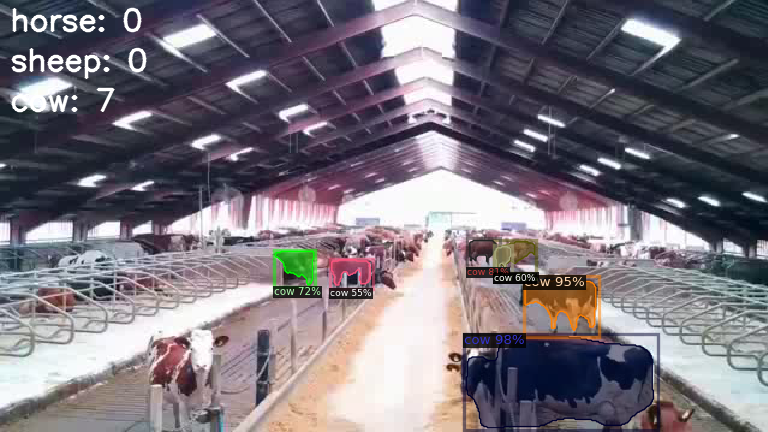

[[[ 55  46  30]
  [ 56  47  31]
  [ 58  49  33]
  ...
  [ 34  26   7]
  [ 34  26   7]
  [ 30  22   3]]

 [[ 49  40  24]
  [ 51  42  26]
  [ 56  47  31]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 35  27   8]]

 [[ 49  40  24]
  [ 51  42  26]
  [ 56  47  31]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 35  27   8]]

 ...

 [[120 126 135]
  [119 125 134]
  [117 123 132]
  ...
  [210 211 206]
  [210 211 206]
  [210 211 206]]

 [[123 129 138]
  [120 126 135]
  [115 121 130]
  ...
  [213 214 209]
  [213 214 209]
  [213 214 209]]

 [[122 128 137]
  [116 122 131]
  [108 114 123]
  ...
  [214 215 210]
  [214 215 210]
  [214 215 210]]]


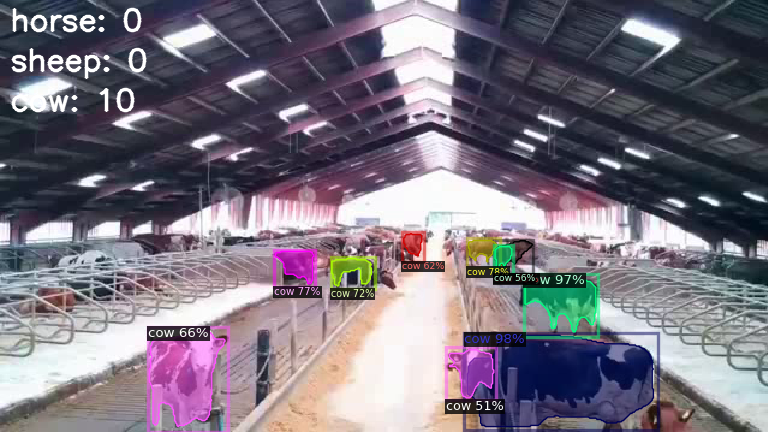

[[[ 59  45  30]
  [ 61  47  32]
  [ 63  49  34]
  ...
  [ 35  27   8]
  [ 35  27   8]
  [ 31  23   4]]

 [[ 54  43  27]
  [ 55  44  28]
  [ 58  47  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 36  28   9]]

 [[ 54  43  27]
  [ 55  44  28]
  [ 58  47  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 36  28   9]]

 ...

 [[116 122 131]
  [116 122 131]
  [117 123 132]
  ...
  [208 209 204]
  [208 209 204]
  [211 212 207]]

 [[126 132 141]
  [119 125 134]
  [113 119 128]
  ...
  [209 210 205]
  [209 210 205]
  [213 214 209]]

 [[126 132 141]
  [115 121 130]
  [107 113 122]
  ...
  [210 211 206]
  [210 211 206]
  [213 214 209]]]


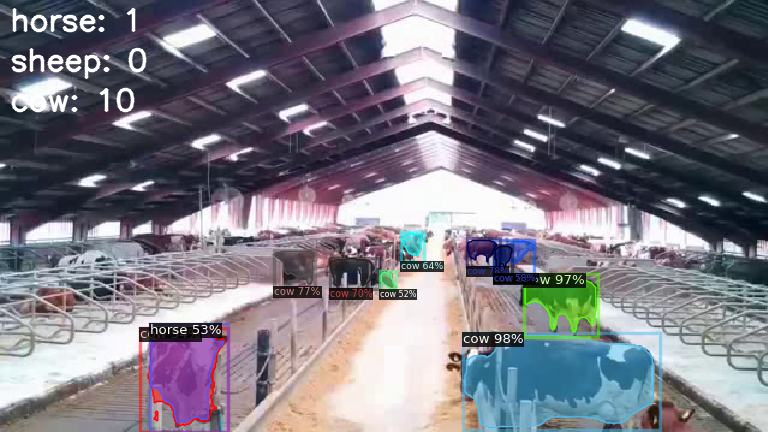

[[[ 61  47  32]
  [ 62  48  33]
  [ 62  48  33]
  ...
  [ 35  27   8]
  [ 35  27   8]
  [ 31  23   4]]

 [[ 55  44  28]
  [ 55  44  28]
  [ 58  47  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 36  28   9]]

 [[ 55  44  28]
  [ 55  44  28]
  [ 58  47  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 36  28   9]]

 ...

 [[116 122 131]
  [116 122 131]
  [117 123 132]
  ...
  [208 209 204]
  [208 209 204]
  [211 212 207]]

 [[126 132 141]
  [119 125 134]
  [113 119 128]
  ...
  [209 210 205]
  [209 210 205]
  [213 214 209]]

 [[126 132 141]
  [115 121 130]
  [107 113 122]
  ...
  [210 211 206]
  [210 211 206]
  [213 214 209]]]


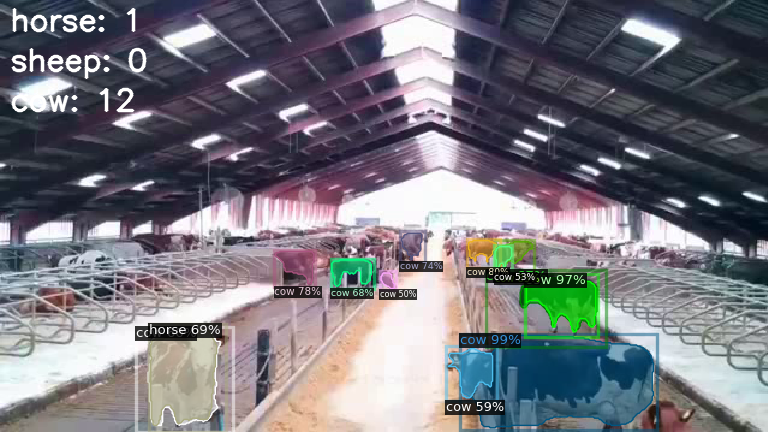

[[[ 61  47  32]
  [ 61  47  32]
  [ 62  48  33]
  ...
  [ 36  28   9]
  [ 36  28   9]
  [ 32  24   5]]

 [[ 55  44  28]
  [ 55  44  28]
  [ 57  46  30]
  ...
  [ 39  31  12]
  [ 39  31  12]
  [ 37  29  10]]

 [[ 55  44  28]
  [ 55  44  28]
  [ 57  46  30]
  ...
  [ 39  31  12]
  [ 39  31  12]
  [ 37  29  10]]

 ...

 [[116 122 131]
  [116 122 131]
  [117 123 132]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[124 130 139]
  [117 123 132]
  [112 118 127]
  ...
  [210 211 206]
  [210 211 206]
  [210 211 206]]

 [[126 132 141]
  [115 121 130]
  [107 113 122]
  ...
  [211 212 207]
  [211 212 207]
  [210 211 206]]]


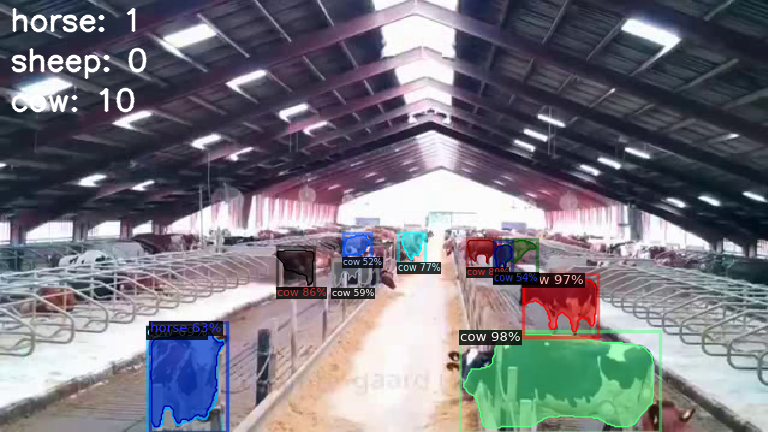

[[[ 60  46  31]
  [ 60  46  31]
  [ 61  47  32]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 35  27   8]]

 [[ 59  47  33]
  [ 59  47  33]
  [ 59  47  33]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 37  29  10]]

 [[ 59  47  33]
  [ 59  47  33]
  [ 59  47  33]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 37  29  10]]

 ...

 [[121 127 136]
  [119 125 134]
  [116 122 131]
  ...
  [209 210 205]
  [209 210 205]
  [208 209 204]]

 [[126 132 141]
  [121 127 136]
  [113 119 128]
  ...
  [211 212 207]
  [211 212 207]
  [209 210 205]]

 [[126 132 141]
  [121 127 136]
  [110 116 125]
  ...
  [214 215 210]
  [214 215 210]
  [215 216 211]]]


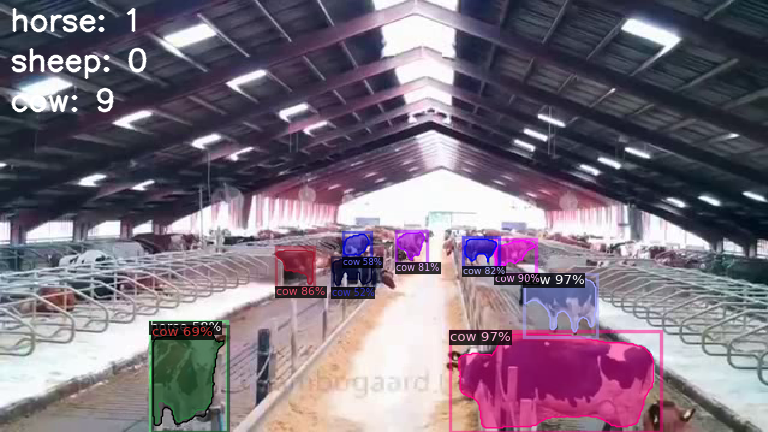

[[[ 60  46  31]
  [ 60  46  31]
  [ 60  46  31]
  ...
  [ 39  31  12]
  [ 39  31  12]
  [ 36  28   9]]

 [[ 61  49  35]
  [ 59  47  33]
  [ 57  45  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 38  30  11]]

 [[ 61  49  35]
  [ 59  47  33]
  [ 57  45  31]
  ...
  [ 38  30  11]
  [ 38  30  11]
  [ 38  30  11]]

 ...

 [[123 129 138]
  [121 127 136]
  [119 125 134]
  ...
  [208 209 204]
  [208 209 204]
  [210 211 206]]

 [[126 132 141]
  [121 127 136]
  [113 119 128]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[124 130 139]
  [120 126 135]
  [109 115 124]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]]


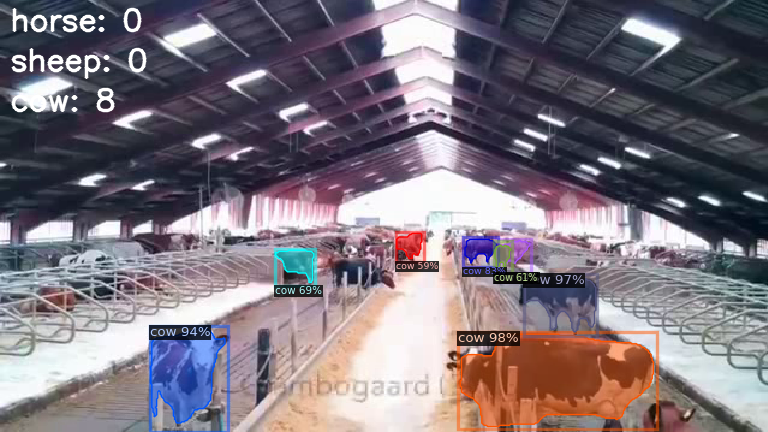

[[[ 62  48  33]
  [ 62  48  33]
  [ 61  47  32]
  ...
  [ 43  35  16]
  [ 43  35  16]
  [ 39  31  12]]

 [[ 62  50  36]
  [ 60  48  34]
  [ 58  46  32]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 [[ 62  50  36]
  [ 60  48  34]
  [ 58  46  32]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 ...

 [[124 130 139]
  [123 129 138]
  [119 125 134]
  ...
  [208 209 204]
  [208 209 204]
  [210 211 206]]

 [[128 134 143]
  [126 132 141]
  [119 125 134]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[127 133 142]
  [124 130 139]
  [119 125 134]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]]


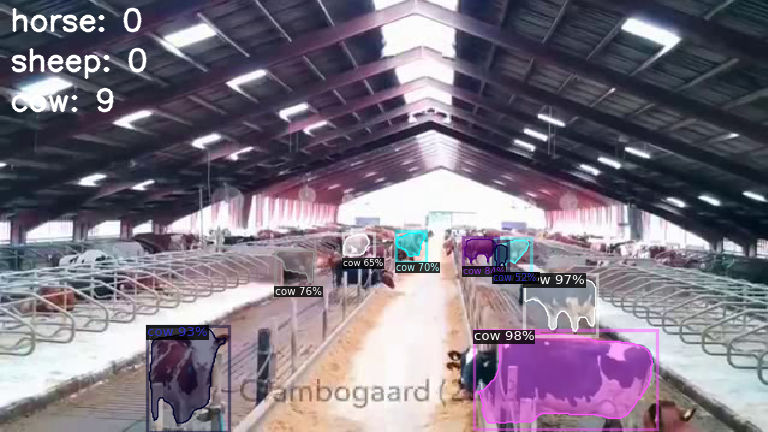

[[[ 62  48  33]
  [ 62  48  33]
  [ 61  47  32]
  ...
  [ 43  35  16]
  [ 43  35  16]
  [ 39  31  12]]

 [[ 62  50  36]
  [ 61  49  35]
  [ 59  47  33]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 [[ 62  50  36]
  [ 61  49  35]
  [ 59  47  33]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 ...

 [[126 132 141]
  [123 129 138]
  [119 125 134]
  ...
  [208 209 204]
  [208 209 204]
  [210 211 206]]

 [[130 136 145]
  [127 133 142]
  [117 123 132]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[129 135 144]
  [126 132 141]
  [117 123 132]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]]


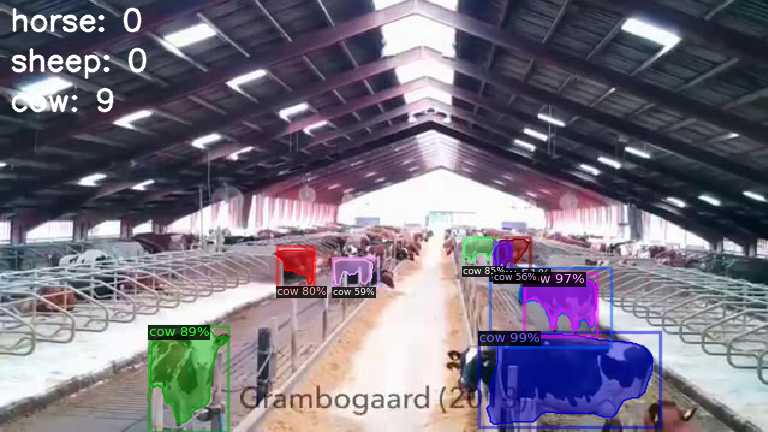

[[[ 64  50  35]
  [ 63  49  34]
  [ 63  49  34]
  ...
  [ 43  35  16]
  [ 43  35  16]
  [ 39  31  12]]

 [[ 65  53  39]
  [ 64  52  38]
  [ 61  49  35]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 [[ 65  53  39]
  [ 64  52  38]
  [ 61  49  35]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 ...

 [[127 133 142]
  [124 130 139]
  [120 126 135]
  ...
  [204 205 200]
  [204 205 200]
  [206 207 202]]

 [[127 133 142]
  [124 130 139]
  [116 122 131]
  ...
  [206 207 202]
  [206 207 202]
  [208 209 204]]

 [[127 133 142]
  [126 132 141]
  [120 126 135]
  ...
  [206 207 202]
  [206 207 202]
  [211 212 207]]]


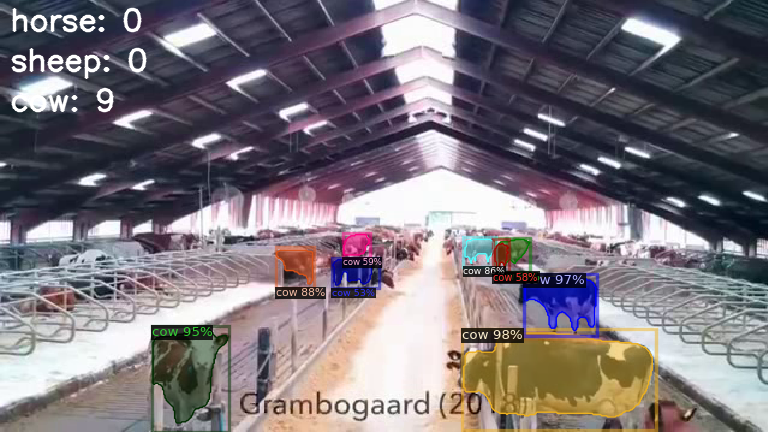

[[[ 64  50  35]
  [ 63  49  34]
  [ 63  49  34]
  ...
  [ 43  35  16]
  [ 43  35  16]
  [ 39  31  12]]

 [[ 65  53  39]
  [ 64  52  38]
  [ 61  49  35]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 [[ 65  53  39]
  [ 64  52  38]
  [ 61  49  35]
  ...
  [ 37  29  10]
  [ 37  29  10]
  [ 38  30  11]]

 ...

 [[128 134 143]
  [127 133 142]
  [122 128 137]
  ...
  [204 205 200]
  [204 205 200]
  [206 207 202]]

 [[127 133 142]
  [126 132 141]
  [121 127 136]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[126 132 141]
  [126 132 141]
  [122 128 137]
  ...
  [210 211 206]
  [210 211 206]
  [213 214 209]]]


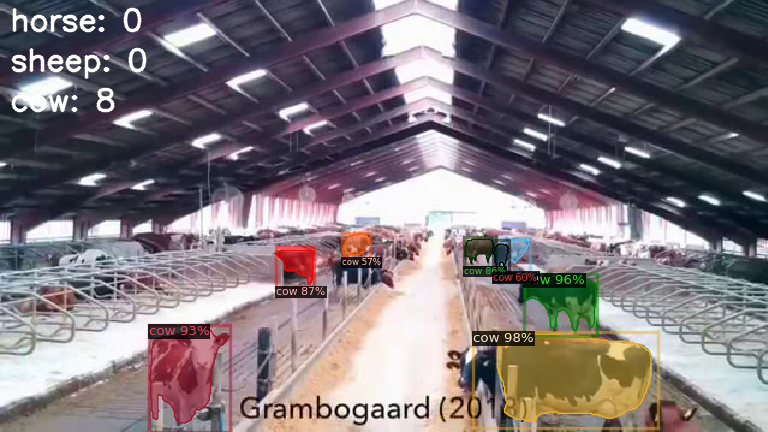

[[[ 62  48  33]
  [ 63  49  34]
  [ 64  50  35]
  ...
  [ 39  29  15]
  [ 39  29  15]
  [ 38  28  14]]

 [[ 65  53  39]
  [ 65  53  39]
  [ 62  50  36]
  ...
  [ 38  28  14]
  [ 38  28  14]
  [ 37  27  13]]

 [[ 65  53  39]
  [ 65  53  39]
  [ 62  50  36]
  ...
  [ 38  28  14]
  [ 38  28  14]
  [ 37  27  13]]

 ...

 [[127 135 144]
  [122 130 139]
  [115 123 132]
  ...
  [207 208 203]
  [207 208 203]
  [207 208 203]]

 [[126 134 143]
  [121 129 138]
  [113 121 130]
  ...
  [209 210 205]
  [209 210 205]
  [210 211 206]]

 [[125 133 142]
  [122 130 139]
  [114 122 131]
  ...
  [209 210 205]
  [209 210 205]
  [213 214 209]]]


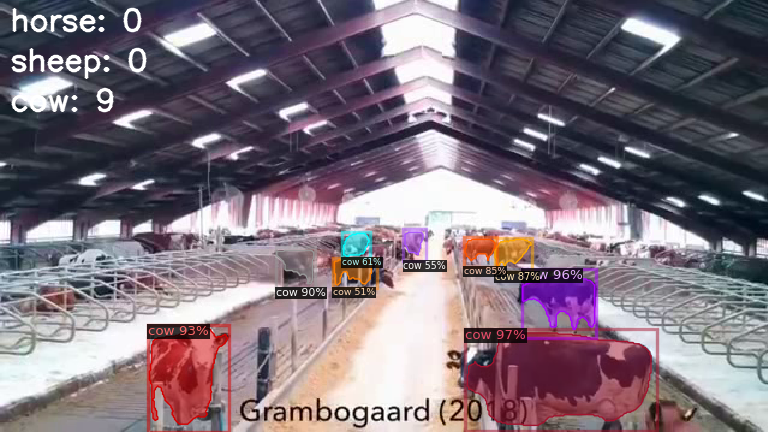

[[[ 62  47  34]
  [ 63  48  35]
  [ 64  49  36]
  ...
  [ 38  27  16]
  [ 38  27  16]
  [ 37  26  15]]

 [[ 67  54  43]
  [ 67  54  43]
  [ 64  51  40]
  ...
  [ 37  26  15]
  [ 37  26  15]
  [ 36  25  14]]

 [[ 67  54  43]
  [ 67  54  43]
  [ 64  51  40]
  ...
  [ 37  26  15]
  [ 37  26  15]
  [ 36  25  14]]

 ...

 [[126 134 143]
  [124 132 141]
  [118 126 135]
  ...
  [209 210 205]
  [209 210 205]
  [209 210 205]]

 [[125 133 142]
  [124 132 141]
  [118 126 135]
  ...
  [210 211 206]
  [210 211 206]
  [213 214 209]]

 [[125 133 142]
  [124 132 141]
  [119 127 136]
  ...
  [209 210 205]
  [209 210 205]
  [213 214 209]]]


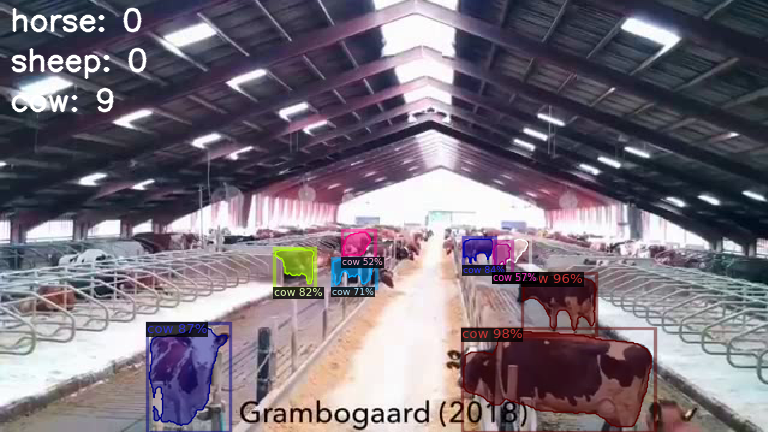

[[[ 61  45  35]
  [ 62  46  36]
  [ 63  47  37]
  ...
  [ 38  27  11]
  [ 38  27  11]
  [ 38  27  11]]

 [[ 69  56  47]
  [ 66  53  44]
  [ 62  49  40]
  ...
  [ 37  27  13]
  [ 37  27  13]
  [ 37  27  13]]

 [[ 69  56  47]
  [ 66  53  44]
  [ 62  49  40]
  ...
  [ 37  27  13]
  [ 37  27  13]
  [ 37  27  13]]

 ...

 [[126 131 137]
  [128 133 139]
  [119 126 132]
  ...
  [211 213 206]
  [211 213 206]
  [215 218 208]]

 [[130 135 141]
  [128 133 139]
  [117 124 130]
  ...
  [211 213 206]
  [211 213 206]
  [214 217 207]]

 [[130 135 141]
  [129 134 140]
  [119 126 132]
  ...
  [209 211 204]
  [209 211 204]
  [208 211 201]]]


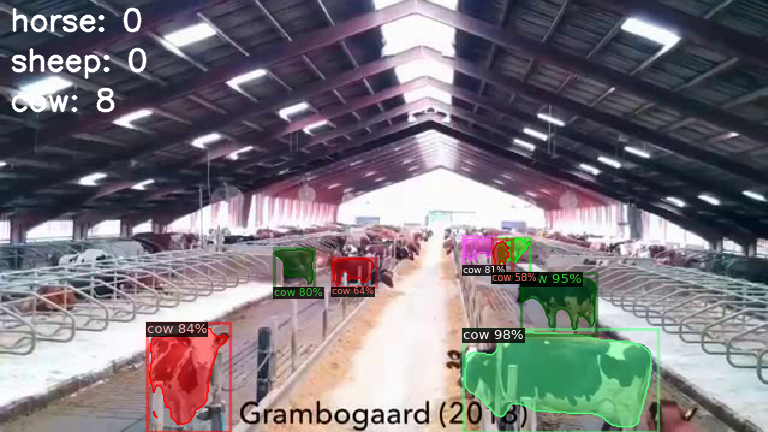

[[[ 63  47  37]
  [ 62  46  36]
  [ 63  47  37]
  ...
  [ 40  29  13]
  [ 40  29  13]
  [ 38  27  11]]

 [[ 72  59  50]
  [ 68  55  46]
  [ 65  52  43]
  ...
  [ 39  29  15]
  [ 39  29  15]
  [ 37  27  13]]

 [[ 72  59  50]
  [ 68  55  46]
  [ 65  52  43]
  ...
  [ 39  29  15]
  [ 39  29  15]
  [ 37  27  13]]

 ...

 [[126 130 139]
  [128 132 141]
  [119 125 134]
  ...
  [211 213 206]
  [211 213 206]
  [215 218 208]]

 [[130 134 143]
  [128 132 141]
  [117 123 132]
  ...
  [211 213 206]
  [211 213 206]
  [214 217 207]]

 [[130 134 143]
  [129 133 142]
  [119 125 134]
  ...
  [209 211 204]
  [209 211 204]
  [208 211 201]]]


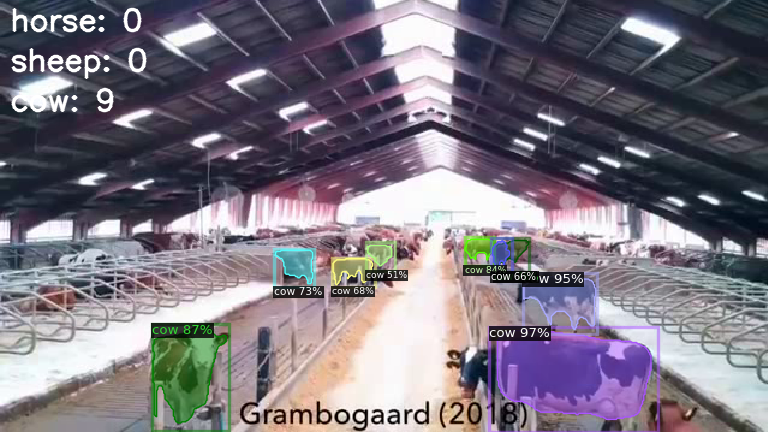

[[[ 66  50  40]
  [ 63  47  37]
  [ 64  48  38]
  ...
  [ 40  29  13]
  [ 40  29  13]
  [ 39  28  12]]

 [[ 75  62  53]
  [ 72  59  50]
  [ 67  54  45]
  ...
  [ 41  31  17]
  [ 41  31  17]
  [ 38  28  14]]

 [[ 75  62  53]
  [ 72  59  50]
  [ 67  54  45]
  ...
  [ 41  31  17]
  [ 41  31  17]
  [ 38  28  14]]

 ...

 [[126 129 142]
  [124 127 140]
  [116 121 134]
  ...
  [209 211 204]
  [209 211 204]
  [211 214 204]]

 [[124 127 140]
  [123 126 139]
  [115 120 133]
  ...
  [209 211 204]
  [209 211 204]
  [210 213 203]]

 [[123 126 139]
  [123 126 139]
  [117 122 135]
  ...
  [207 209 202]
  [207 209 202]
  [204 207 197]]]


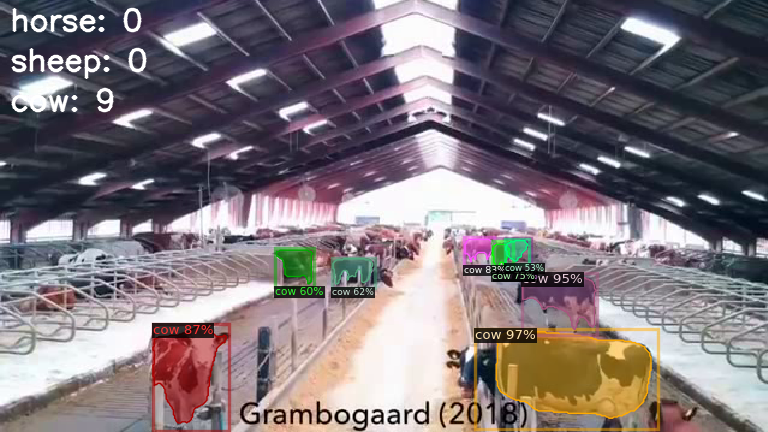

[[[ 62  46  36]
  [ 60  44  34]
  [ 61  45  35]
  ...
  [ 40  29  13]
  [ 40  29  13]
  [ 39  28  12]]

 [[ 85  72  63]
  [ 78  65  56]
  [ 68  55  46]
  ...
  [ 39  29  15]
  [ 39  29  15]
  [ 36  26  12]]

 [[ 85  72  63]
  [ 78  65  56]
  [ 68  55  46]
  ...
  [ 39  29  15]
  [ 39  29  15]
  [ 36  26  12]]

 ...

 [[126 129 142]
  [124 127 140]
  [116 121 134]
  ...
  [210 212 205]
  [210 212 205]
  [211 214 204]]

 [[124 127 140]
  [123 126 139]
  [115 120 133]
  ...
  [208 210 203]
  [208 210 203]
  [210 213 203]]

 [[123 126 139]
  [123 126 139]
  [117 122 135]
  ...
  [204 206 199]
  [204 206 199]
  [204 207 197]]]


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video3.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video3.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    print(fps,width,height,fourcc,output_path)
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)
        print(vis_frame)
        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=uNqFbEng7_A&ab_channel=alittaalitta"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 0  # Start time in seconds
    end_time = 0.5  # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video5.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video3.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video4.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=h7k6P12gfic&ab_channel=TheParakeet"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 24  # Start time in seconds
    end_time =26   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video7.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video3.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video4.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=h7k6P12gfic&ab_channel=TheParakeet"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 215  # Start time in seconds
    end_time =217   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video7.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video3.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video4.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=h7k6P12gfic&ab_channel=TheParakeet"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 469  # Start time in seconds
    end_time =471   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video7.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video8.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video8.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=NakeutCQRvo&ab_channel=MG-Farm"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 60  # Start time in seconds
    end_time =62   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video8.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


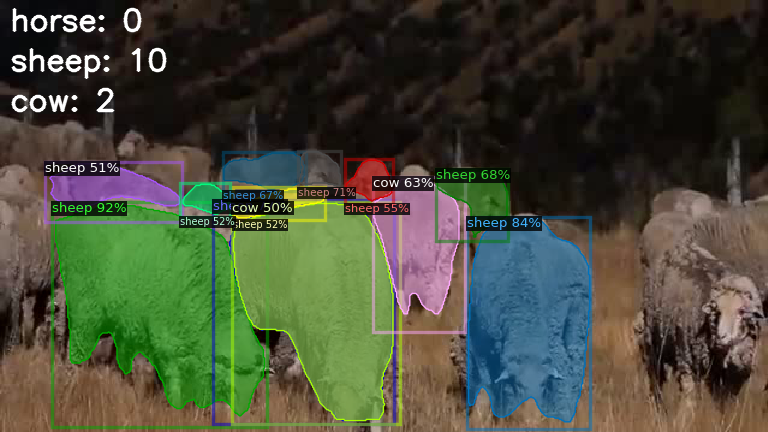

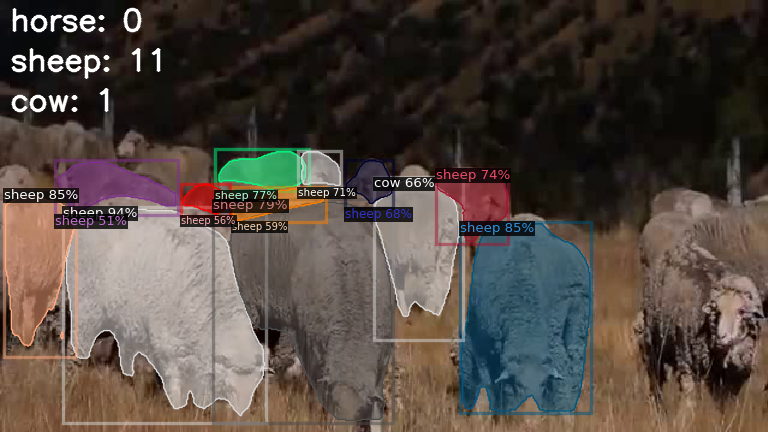

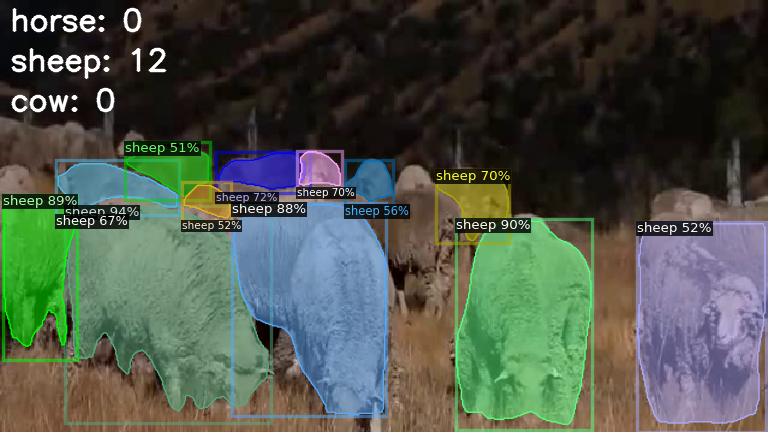

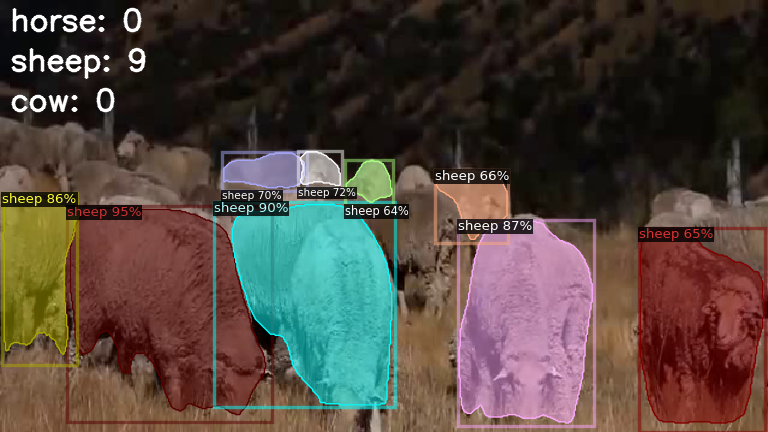

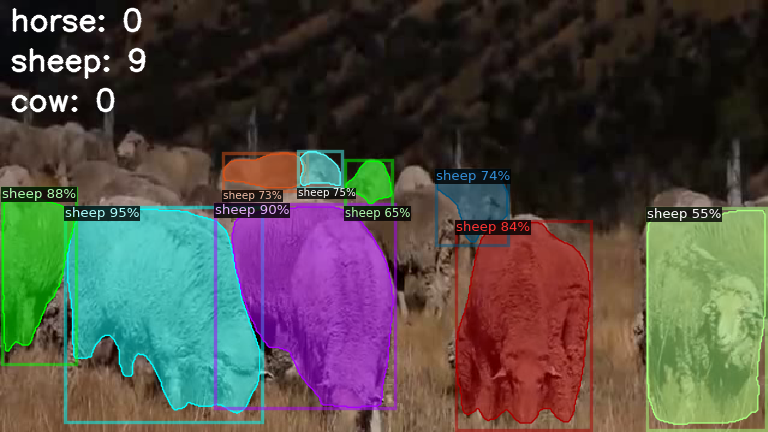

...

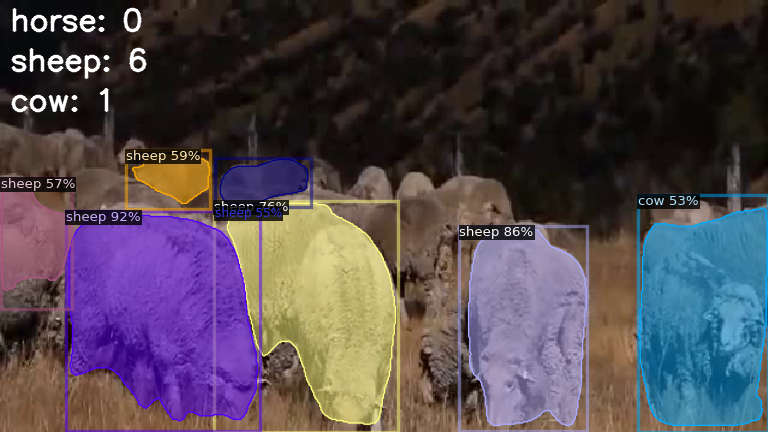

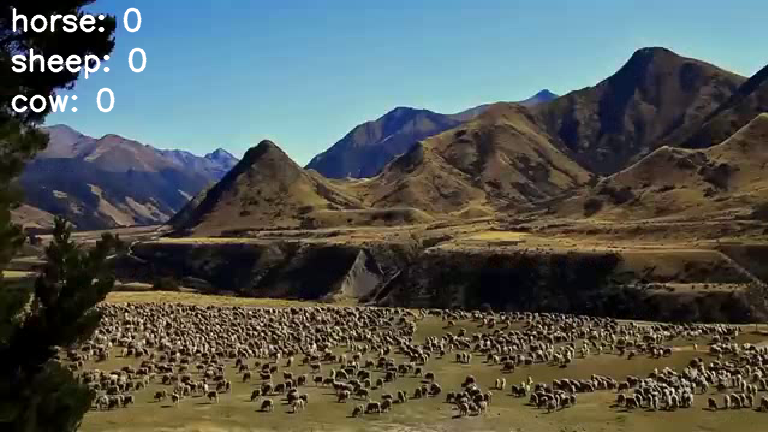

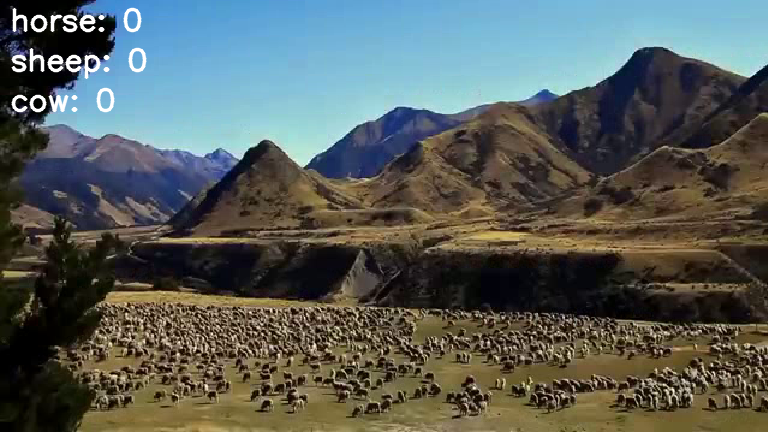

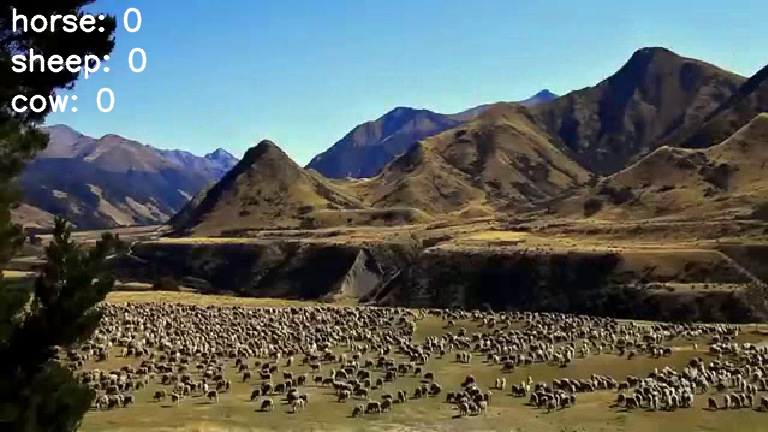

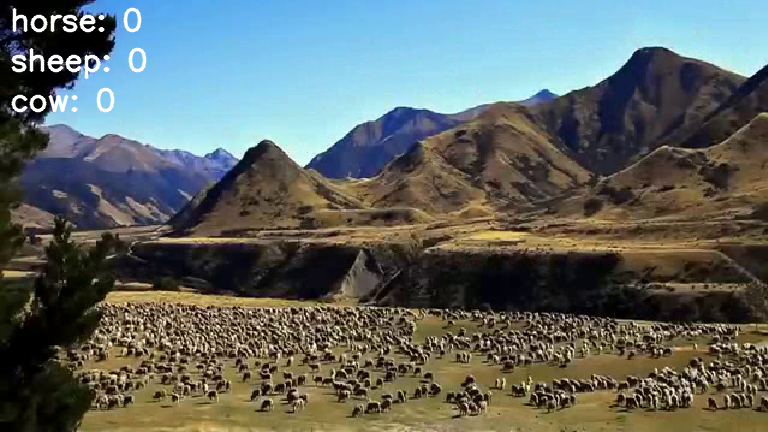

In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video8.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video8.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=NakeutCQRvo&ab_channel=MG-Farm"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 45  # Start time in seconds
    end_time =46   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video8.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video9.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video9.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=hN-2jtaIh8o&ab_channel=Tony98-Discovery"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 206  # Start time in seconds
    end_time =208   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video9.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video9.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video9.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=hN-2jtaIh8o&ab_channel=Tony98-Discovery"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 10  # Start time in seconds
    end_time =12   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video9.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video9.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video9.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=hN-2jtaIh8o&ab_channel=Tony98-Discovery"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 365  # Start time in seconds
    end_time =367   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video9.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from pytube import YouTube
from google.colab.patches import cv2_imshow
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_folder, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    output_path = os.path.join(output_folder, "downloaded_video9.mp4")
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        cropped_video_folder = os.path.join(output_folder, "cropped")
        os.makedirs(cropped_video_folder, exist_ok=True)
        cropped_video_path = os.path.join(cropped_video_folder, "cropped_video9.mp4")

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Register dataset dan metadata
def register_metadata():
    dataset_name = "my_dataset1"
    MetadataCatalog.get(dataset_name).thing_classes=["horse","sheep","cow"]
    # Register dataset (assuming your dataset is already in COCO format)
    # DatasetCatalog.register(dataset_name, lambda: load_coco_json("path_to_your_coco_annotation.json", "path_to_your_dataset_images"))
    return dataset_name

# Prediksi pada setiap frame
def process_video(video_path, predictor, metadata_name,output_path):
    cap = cv2.VideoCapture(video_path)

    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)

        #outputs = predictor(frame)
        instances = outputs["instances"].to("cpu")
        pred_classes = instances.pred_classes.tolist()
        class_counts = {class_name: pred_classes.count(idx) for idx, class_name in enumerate(MetadataCatalog.get(metadata_name).thing_classes)}

        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=1.2)
        #out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        out_frame = v.draw_instance_predictions(instances)
        vis_frame = out_frame.get_image()[:, :, ::-1].copy()

        x, y = 10, 30
        for class_name, count in class_counts.items():
            text = f"{class_name}: {count}"
            cv2.putText(vis_frame, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            y += 40

        # Tampilkan frame menggunakan cv2_imshow untuk Colab
        cv2_imshow(vis_frame)

        out.write(vis_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=hN-2jtaIh8o&ab_channel=Tony98-Discovery"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 275  # Start time in seconds
    end_time =279   # End time in seconds
    output_video_path = os.path.join(output_folder, "output_video9.mp4")

    # Register metadata
    metadata_name = register_metadata()

    # Download and crop video
    video_path = download_video(youtube_url, output_folder, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    #process_video(video_path, predictor, metadata_name)
    process_video(video_path, predictor, metadata_name, output_video_path)

if __name__ == "__main__":
    main()


In [ ]:
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("aa3Vlz1mawQ&ab_channel=HawkFarm", width=500)
display(video)

In [ ]:
!pip install youtube-dl
!youtube-dl https://www.youtube.com/watch?v=aa3Vlz1mawQ&ab_channel=HawkFarm -f 22 -o /content/drive/MyDrive/SimulationThesis-02/input/video.mp4
!ffmpeg -i /content/drive/MyDrive/SimulationThesis-02/input/video.mp4 -t 00:00:06 -c:v copy /content/drive/MyDrive/SimulationThesis-02/input/video.mp4

/bin/bash: line 1: -f: command not found
[youtube] aa3Vlz1mawQ: Downloading webpage
ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-lib

In [ ]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes) with the "demo.py" tool we provided in the repo.
#!git clone https://github.com/facebookresearch/detectron2
# Note: this is currently BROKEN due to missing codec. See https://github.com/facebookresearch/detectron2/issues/2901 for workaround.
%run detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [ ]:
import cv2
import torch
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from pytube import YouTube
from IPython.display import display, HTML
import os

# Fungsi untuk mendownload video dari YouTube
def download_video(youtube_url, output_path, start_time=0, end_time=None):
    yt = YouTube(youtube_url)
    stream = yt.streams.filter(file_extension='mp4').first()
    stream.download(filename=output_path)

    if end_time is not None:
        # Crop the video to the specified duration
        cap = cv2.VideoCapture(output_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        cropped_video_path = 'cropped_' + output_path
        out = cv2.VideoWriter(cropped_video_path, fourcc, fps, (width, height))

        cap.set(cv2.CAP_PROP_POS_MSEC, start_time * 1000)
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            if current_time > end_time:
                break
            out.write(frame)

        cap.release()
        out.release()
        return cropped_video_path
    return output_path

# Konfigurasi Detectron2
def setup_cfg(model_path):
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Update with the number of classes in your dataset
    cfg.MODEL.WEIGHTS = model_path
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    return cfg

# Prediksi pada setiap frame
def process_video(video_path, predictor):
    cap = cv2.VideoCapture(video_path)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        outputs = predictor(frame)
        v = Visualizer(frame[:, :, ::-1], MetadataCatalog.get(predictor.cfg.DATASETS.TRAIN[0]), scale=1.2)
        out_frame = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Tampilkan frame menggunakan OpenCV
        cv2.imshow('Frame', out_frame.get_image()[:, :, ::-1])

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

def main():
    youtube_url = "https://www.youtube.com/watch?v=uNqFbEng7_A&ab_channel=alittaalitta"
    output_folder = "/content/drive/MyDrive/SimulationThesis-02/output"
    os.makedirs(output_folder, exist_ok=True)
    output_path = os.path.join(output_folder, "downloaded_simulation-03.mp4")
    model_path = "/content/drive/MyDrive/SimulationThesis-02/dataset/data/data_val/output/model_final.pth"  # Update with your model path
    start_time = 0  # Start time in seconds
    end_time = 60  # End time in seconds

    # Download and crop video
    video_path = download_video(youtube_url, output_path, start_time, end_time)

    # Setup model
    cfg = setup_cfg(model_path)
    predictor = DefaultPredictor(cfg)

    # Process video
    process_video(video_path, predictor)

if __name__ == "__main__":
    main()


In [ ]:
import shutil

# Define the paths
source_folder_path = '/content/dataset'  # Change this to the path of your folder
destination_folder_path = '/content/drive/MyDrive/SimulationThesis-02'  # Change this to the destination folder in your Google Drive

# Move the folder to Google Drive
shutil.move(source_folder_path, destination_folder_path)

'/content/drive/MyDrive/SimulationThesis-02/dataset'

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.config import get_cfg
from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer

# Fungsi untuk memuat model yang sudah dilatih sebelumnya
def load_model_and_config(config_file, weights_file):
    cfg = get_cfg()
    cfg.merge_from_file(config_file)
    cfg.MODEL.WEIGHTS = weights_file
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Ambang batas untuk deteksi objek
    cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"  # Menggunakan GPU jika tersedia
    model = build_model(cfg)
    DetectionCheckpointer(model).load(weights_file)
    model.eval()
    return cfg, model

# Memuat model yang sudah dilatih sebelumnya
config_file = "path_to_your_config_file.yaml"
weights_file = "path_to_your_trained_weights.pth"
cfg, model = load_model_and_config(config_file, weights_file)

# Memuat dataset validasi
DatasetCatalog.register("dataset_validation", your_validation_dataset_function)
MetadataCatalog.get("dataset_validation").set(thing_classes=your_classes_list)
dataset_metadata = MetadataCatalog.get("dataset_validation")

# Membuat evaluator COCO
evaluator = COCOEvaluator("dataset_validation", cfg, False, output_dir="./output")

# Membuat data loader untuk dataset validasi
val_loader = build_detection_test_loader(cfg, "dataset_validation")

# Mengevaluasi model menggunakan evaluator dan data loader
inference_on_dataset(model, val_loader, evaluator)

# Mendapatkan hasil evaluasi
evaluator.evaluate()

# Mendapatkan hasil evaluasi berupa AP untuk setiap kelas
coco_evaluator = evaluator.coco_evaluator
stats = coco_evaluator.coco_eval['bbox'].stats
ap = stats[0]  # AP untuk setiap kelas
class_names = [str(i) for i in range(len(ap))]  # Nama kelas
mAP = stats[1]  # mAP

# Plotting AP untuk setiap kelas
plt.figure(figsize=(10, 5))
plt.bar(class_names, ap)
plt.xlabel('Kelas Objek')
plt.ylabel('Average Precision (AP)')
plt.title('Average Precision untuk Setiap Kelas Objek')
plt.xticks(rotation=45)
plt.ylim(0, 1.0)  # Rentang nilai AP dari 0 hingga 1
plt.grid(axis='y')
plt.tight_layout()

# Menampilkan plot AP
plt.show()

# Menampilkan juga MAP
print("Mean Average Precision (mAP):", mAP)